# Spatial Analysis
---

In [1]:
import matplotlib.pyplot as plt

# font
plt.rcParams['font.sans-serif'] = ['Arial']
LABEL_FONT = {
    "fontsize": 12,
    "weight": "bold",
}    

# colors
BLUE = '#2878B5'
LIGHTBLUE = '#9AC9DB'
ORANGE = '#F8AC8C'
RED = '#C82423'
PINK = '#FF8884'
GREY = '#9E9E9E'
DEEPGREEN = '#32B897'
GREEN = '#96CCCB'

plt.rcParams['figure.dpi'] = 500

In [2]:
from analysis import Aggregator

# bins
agg = Aggregator()
SPEED_BIN = agg.SPEED_BIN
ACC_BIN = agg.ACC_BIN
DECEL_BIN = agg.BRAKE_DECEL_BIN
VSP_BIN = agg.VSP_BIN

import numpy as np
OpModeERs = np.load("./data/agg/OpModeERs.npy")

## 1 Geo Data Preparation

### 1.1 Extract roadnet as GeoDataFrame

In [3]:
# get road network from a bounding box
import osmnx as ox

north, south, east, west = 30.735, 30.650, 104.133, 104.034,

custom_filter = ('["highway"]["area"!~"yes"]["access"!~"private"]'
                 '["highway"!~"abandoned|bridleway|bus_guideway|construction|corridor|cycleway|'
                 'elevator|escalator|footway|path|pedestrian|planned|platform|proposed|raceway|steps|track"]'
                 '["service"!~"emergency_access|private"]')
graph = ox.graph_from_bbox(
    north, south, east, west,
    simplify=True,
    custom_filter=custom_filter,
)
# ox.plot_graph(graph, node_size=0, figsize=(6,6))

# save as GeoDataFrame
roadnet = ox.graph_to_gdfs(graph, nodes=False)
roadnet = roadnet.explode('osmid')

### 1.2 Simplify the roadnet by merging

In [4]:
# step1: merge highway type
roadnet_merge = roadnet.copy()

# define road type orders
highway_types = ["motorway", "trunk", "primary", "secondary", "tertiary", "unclassified", "residential",
                 "motorway_link", "trunk_link", "primary_link", "secondary_link", "tertiary_link", "living_street",
                 "service"]

def highway_merge(highway):
    if type(highway) == str:
        return highway
    else:
        # if there are two or more than highway types in the list, return the one with the highest class
        index = [highway_types.index(i) for i in highway]
        return highway[np.argmin(index)]
# merge
roadnet_merge['highway'] = roadnet['highway'].apply(highway_merge)

In [ ]:
import pandas as pd
from tqdm import tqdm
from shapely import ops, multilinestrings

# step2: merge geometry
roadnet_simplified = {"osmid":[], "road type":[], "geometry":[], "length":[]}

for osmid in tqdm(roadnet_merge.osmid.unique()):
    
    road = roadnet_merge[roadnet_merge["osmid"] == osmid]

    # add osmid
    roadnet_simplified["osmid"].append(osmid)

    # add road type
    roadTypes = road["highway"].tolist()
    # get the count of each type
    typeCounts = {t:roadTypes.count(t) for t in set(roadTypes)}
    # get the type with the most count
    maxTypes = [t for t in typeCounts.keys() if typeCounts[t] == max(typeCounts.values())]
    # if there are more than two types, return the one with the highest class
    roadnet_simplified["road type"].append(roadTypes[np.argmin([highway_types.index(i) for i in roadTypes])])

    # add geometry
    roadnet_simplified["geometry"].append(ops.linemerge(multilinestrings(road["geometry"].to_list())))
    
    # add length
    roadnet_simplified["length"].append(road["length"].sum())

roadnet_simplified = pd.DataFrame(roadnet_simplified)
roadnet_simplified

In [ ]:
# save as shapefile
import geopandas as gpd
gdf = gpd.GeoDataFrame(roadnet_simplified, geometry="geometry")
# gdf.to_file("./data/geo/roadnet/roadnet_simplified.shp")

### 1.3 Intersection extraction

In [5]:
# get road network from a bounding box
import osmnx as ox

north, south, east, west = 30.734674878580773, 30.650908445140583, 104.13222287837313, 104.03445064977247,
custom_filter = ('["highway"]["area"!~"yes"]["access"!~"private"]'
                 '["highway"!~"abandoned|bridleway|bus_guideway|construction|corridor|cycleway|'
                 'elevator|escalator|footway|path|pedestrian|planned|platform|proposed|raceway|steps|track"]'
                 '["service"!~"emergency_access|private"]')
graph = ox.graph_from_bbox(
    north, south, east, west,
    simplify=True,
    custom_filter=custom_filter,
)

# extract node to gdf
node, link = ox.graph_to_gdfs(graph)

# save as shapefile
import geopandas as gpd
gdf = gpd.GeoDataFrame(node, geometry="geometry")
# gdf.to_file("./data/geo/nodes/nodes.shp")

## 2 The study area

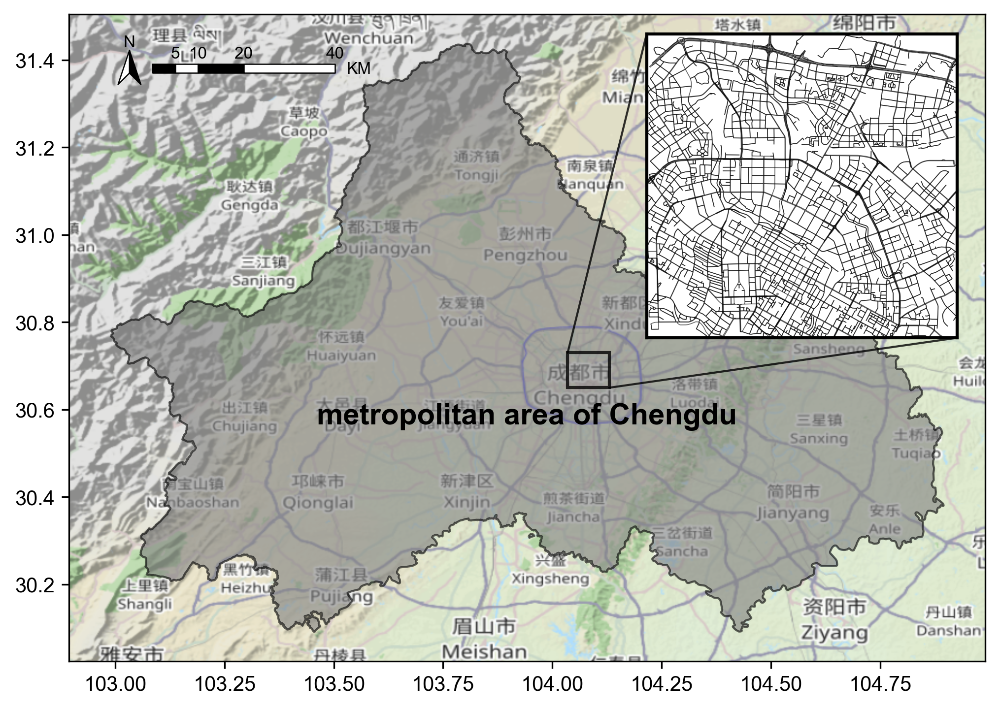

In [ ]:
import contextily as ctx
import osmnx as ox
import transbigdata as tbd

# geo data preparation
Chengdu_bound = ox.geocode_to_gdf("Chengdu, Sichuan, China")  # bounding of Chengdu city
north, south, east, west = 30.73, 30.65, 104.13, 104.035
road_graph = ox.graph_from_bbox(north, south, east, west, network_type='drive')
road_graph = ox.graph_to_gdfs(road_graph, nodes=False)

fig, ax = plt.subplots(1, 1, figsize=(8,6))

# plot Chengdu bound
Chengdu_bound.plot(ax=ax, facecolor='GREY', edgecolor='k', alpha=0.6)
ctx.add_basemap(ax=ax, crs=Chengdu_bound.crs.to_string(), source='https://c.tile.thunderforest.com/cycle/{z}/{x}/{y}.png?apikey=41f4f936f1d148f69cbd100812875c88')
ax.text(0.5, 0.4, "metropolitan area of Chengdu", transform=ax.transAxes, fontweight='bold', fontsize='x-large', ha='center', va='top')

# plot road graph
ax_ = ax.inset_axes([0.55, 0.5, 0.5, 0.47], transform=ax.transAxes)
road_graph.plot(ax=ax_, facecolor=None, color='k', alpha=0.6, linewidth=0.4)
ax_.set_xlim(west, east)
ax_.set_ylim(south, north)
ax_.set_xticks([])
ax_.set_yticks([])
for loc in ['left', 'right', 'top', 'bottom']:
    ax_.spines[loc].set_color('k')
    ax_.spines[loc].set_linewidth(1.5)
ax.indicate_inset_zoom(ax_, edgecolor="black", alpha=0.8, linewidth=1.5)

# scale bar
tbd.plotscale(ax=ax, bounds=[west, south, east, north], accuracy=5000, rect=[-10, 9])

plt.show()

## 3 Spatial analysis

### 3.1 Link aggregation

In [3]:
import pickle
with open("./data/agg/agg_link.pkl", 'rb') as f:
    agg_link = pickle.load(f)

import geopandas as gpd
roadnet = gpd.read_file("./data/geo/roadnet/roadnet_simplified.shp")

# link-level aggregation
agg_link = agg_link.join(roadnet.set_index('osmid'))
agg_link = gpd.GeoDataFrame(agg_link, geometry='geometry')

In [4]:
# parameter calculation
def calParams(aggFile):
    aggFile['brakeFrac'] = aggFile['brakeCount'] / aggFile['trajCount']
    aggFile['brakeFreq'] = aggFile['brakeEventNum'] / aggFile['mileage']  # #/km
    aggFile['brakeTimeMean'] = aggFile['brakeCount'] / aggFile['brakeEventNum']  # sec
    aggFile['OpModeFrac'] = aggFile['OpModeCount'] / aggFile['trajCount']
    aggFile['brakeDecelMean'] = aggFile['brakeDecelMean'].apply(np.abs)
    aggFile['PM10 ER Avg'] = aggFile['OpModeFrac'].apply(lambda x: sum(x * OpModeERs))
    aggFile['Daily BWE'] = aggFile['PM10 ER Avg'] * aggFile['trajCount'] / 3600 / 30
    aggFile['PM10 EF Avg'] = aggFile['Daily BWE'] * 30 / aggFile['mileage'] * 1000  # mg/km/veh
    aggFile.replace(np.inf, 0, inplace=True)
    return aggFile

In [5]:
agg_link.dropna(inplace=True)
# agg_link = agg_link[~(agg_link['brakeCount'] == 0)].copy()
agg_link = calParams(agg_link)

int_col = ['trajCount', 'brakeCount', 'brakeEventNum']
float_col = ['mileage', 'speedMean', 'accMean', 'VSPMean', 'brakeDecelMean', 'length', 'brakeFrac', 'brakeFreq', 'brakeTimeMean', 'PM10 ER Avg', 'Daily BWE', 'PM10 EF Avg']
# float_col = ['mileage', 'speedMean', 'accMean', 'VSPMean', 'brakeDecelMean', 'length', 'brakeFrac', 'brakeFreq', 'PM10 ER Avg', 'Daily BWE', 'PM10 EF Avg']
agg_link[int_col] = agg_link[int_col].astype('int32')
agg_link[float_col] = agg_link[float_col].astype('float32')
agg_link['trajVol'] = agg_link['trajCount'] / agg_link['length'] * 1000 / 30 / 24 # #/km/h

Trajectory-weighted average EF

In [6]:
# traj volumne weighted average
import numpy as np
weight = 'trajCount'
agg_link.fillna(0, inplace=True)
weighted_ave_EF = sum(agg_link['PM10 EF Avg'] * agg_link[weight]) / agg_link[weight].sum()
weighted_std_EF = agg_link.apply(lambda x: x[weight]*np.power((x['PM10 EF Avg']-weighted_ave_EF), 2), axis=1).sum()
weighted_std_EF /= agg_link[weight].sum()
weighted_std_EF = np.sqrt(weighted_std_EF)
weighted_ave_EF, weighted_std_EF

(26.847839763868745, 4.25305168628656)

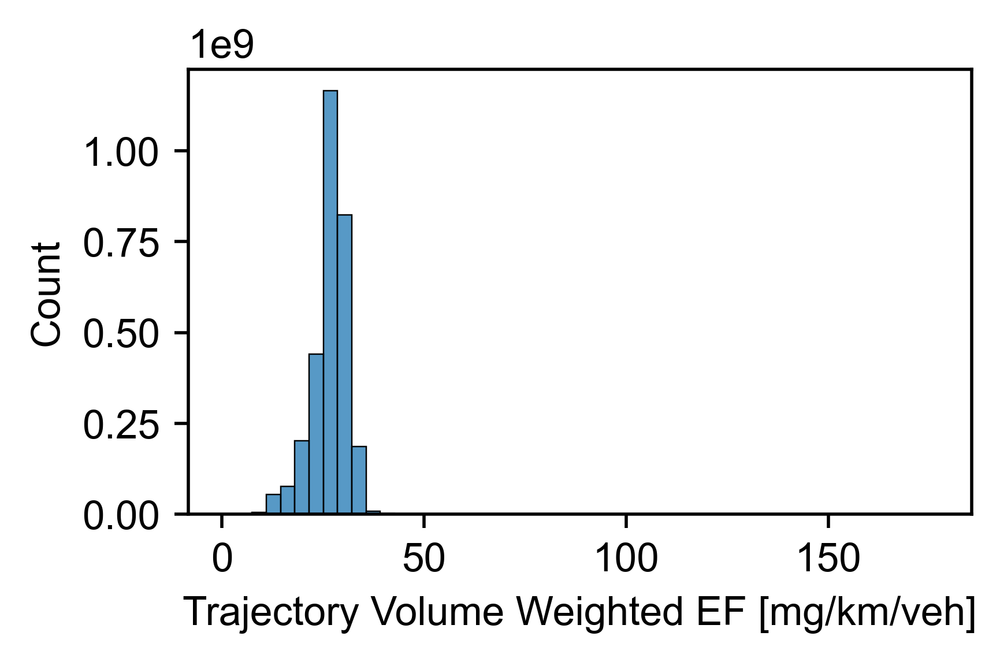

In [24]:
import seaborn as sns
import matplotlib.pyplot as plt

fig, ax = plt.subplots(1,1, figsize=(3.5,2))
sns.histplot(agg_link, x='PM10 EF Avg', weights='trajCount', kde=False, bins=50, ax=ax)
ax.set_xlabel("Trajectory Volume Weighted EF [mg/km/veh]")
plt.show()

In [7]:
lengths = agg_link[['length', 'road type']].groupby(by='road type').sum()
restricted = lengths.loc[["motorway", "trunk", "motorway_link", "trunk_link"]]['length'].sum()
all = lengths['length'].sum()
restricted
1 - restricted / all  # unrestricted proportion

0.8498722314834595

84.99% of the roads are unrestricted.

In [8]:
# road types
highway_types = ["motorway", "trunk", "primary", "secondary", "tertiary", "unclassified", "residential","living_street",
                 "service", "motorway_link", "trunk_link", "primary_link", "secondary_link", "tertiary_link", ]
# # bound
east, west, north, south = 104.1269937640354, 104.03967976411019, 30.73017827690331, 30.655405046818046
east, west, north, south

(104.1269937640354, 104.03967976411019, 30.73017827690331, 30.655405046818046)

C:\Users\Ricky Chen\AppData\Local\Temp\ipykernel_7368\663289154.py:4: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('Spectral', 14) # define the colormap


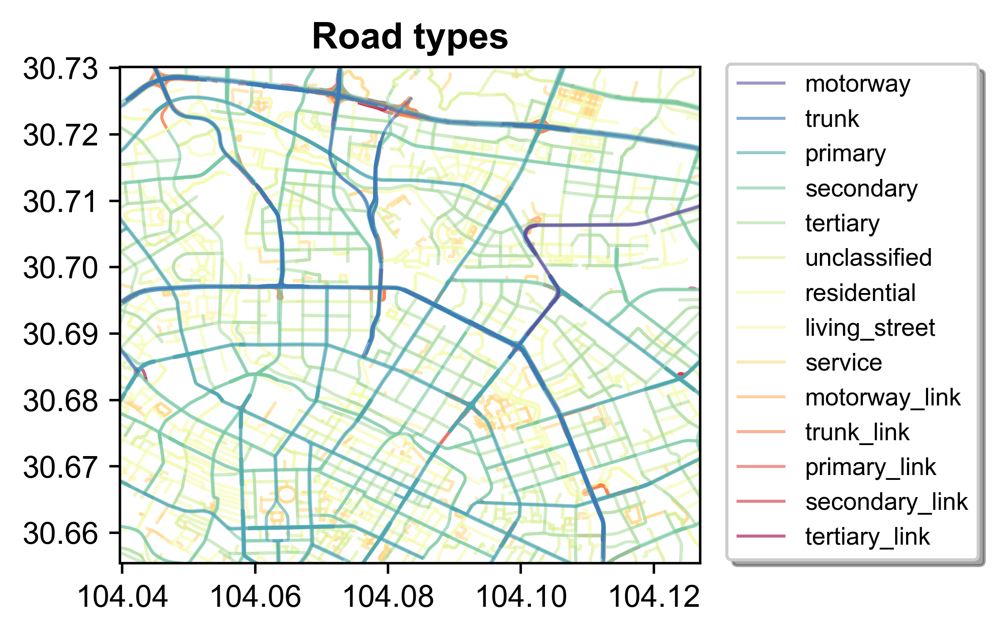

In [11]:
fig, ax = plt.subplots(1,1, figsize=(4,4), constrained_layout=True)

# extract all colors from cmap
cmap = plt.cm.get_cmap('Spectral', 14) # define the colormap
cmaplist = [cmap(i) for i in range(cmap.N)]

roadtypes = reversed(highway_types)
for roadtype, color in zip(roadtypes, cmaplist):
    agg_link[agg_link['road type'] == roadtype].plot(ax=ax, linewidth=1, color=color, alpha=0.6, label=roadtype)

ax.set_xlim(west, east)
ax.set_ylim(south, north)
ax.set_title('Road types', fontdict=LABEL_FONT)
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles[::-1], labels[::-1], bbox_to_anchor=(1.5, 1.03), bbox_transform=ax.transAxes, fontsize=8, shadow=True)
plt.show()

In [102]:
# elevation
from osgeo import gdal
from preprocessing.geo import geo2xy
gdal.UseExceptions()
dem = gdal.Open("./data/geo/AP_27359_FBS_F0600_RT1.dem.tif")
band = dem.GetRasterBand(1)
ele = band.ReadAsArray()

# get region elevation
x_min, y_max = geo2xy(dem, east, north)
x_max, y_min = geo2xy(dem, west, south)
region = ele[x_min:x_max, y_min:y_max]
region.min(), region.max()

(441, 508)

In [ ]:
# transform (lon, lat) to (col, row)
from shapely.geometry import LineString, MultiLineString
def convert_linestring(linestring): 
    new_coords = [reversed(geo2xy(dem, lon, lat)) for lon, lat in linestring.coords] 
    return LineString(new_coords)
def convert_multilinestring(multilinestring):
    new_lines = [convert_linestring(linestring) for linestring in multilinestring.geoms]
    return MultiLineString(new_lines)
def convert_geometry(geometry):
    if isinstance(geometry, LineString):
        return convert_linestring(geometry)
    elif isinstance(geometry, MultiLineString):
        return convert_multilinestring(geometry)
    else:
        return geometry
agg_link['geometry_xy'] = agg_link['geometry'].apply(convert_geometry)
agg_link.set_geometry('geometry_xy', inplace=True)

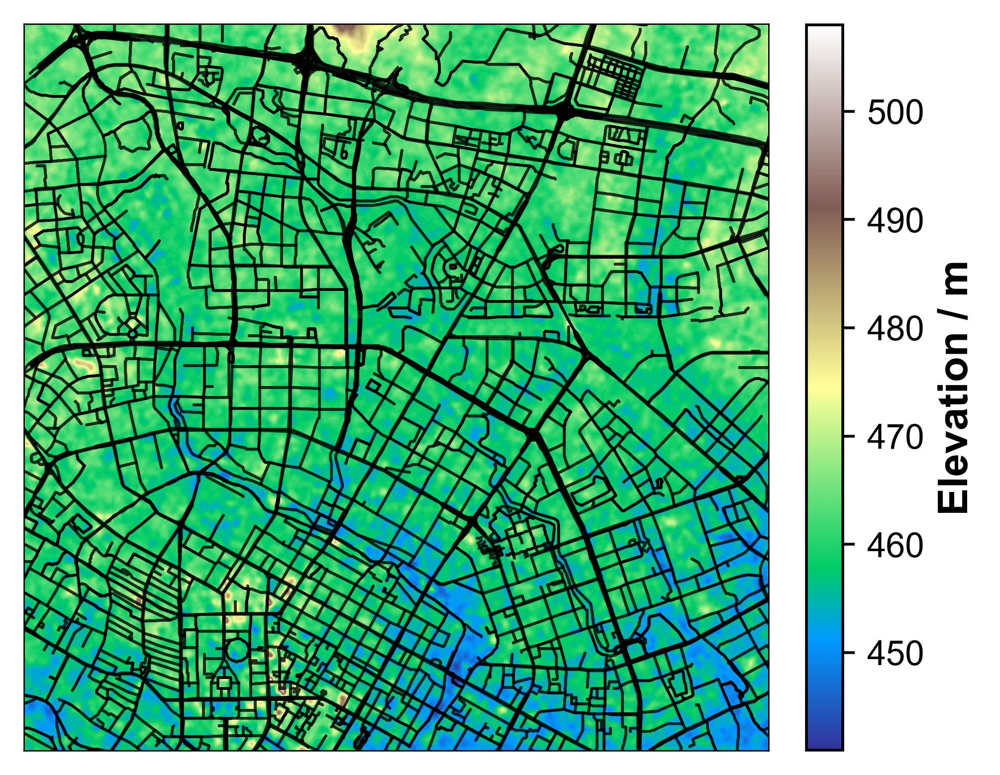

In [153]:
import matplotlib.colors as mcolors
fig, ax = plt.subplots(1,1, figsize=(4,3), constrained_layout=True)

# plot elevation
norm = mcolors.Normalize(vmin=region.min(), vmax=region.max()) 
im = ax.imshow(ele, zorder=10, cmap='terrain', norm=norm)
cbar = fig.colorbar(im, ax=ax)
cbar.set_label('Elevation / m', fontdict=LABEL_FONT)

# plot road map
agg_link.plot(ax=ax, linewidth=0.8, color='k', alpha=0.8, zorder=20)

# axis
plt.ylim(x_max, x_min)
plt.xlim(y_min, y_max)
plt.xticks([])
plt.yticks([])
plt.show()

### 3.2 Road type aggregation

In [12]:
# # cumulative data
# agg_link_cum = agg_link.copy()
# for col in ['speedMean', 'accMean', 'VSPMean', 'brakeDecelMean']:
#     agg_link_cum[col] = agg_link_cum[col] * agg_link_cum['trajCount']
# agg_type = agg_link_cum[['trajCount', 'brakeCount', 'brakeEventNum', 'mileage', 'speedMean', 'accMean', 'VSPMean', 'brakeDecelMean', 'OpModeCount', 'road type', 'length']].groupby(by='road type').sum()

# # mean data
# for col in ['speedMean', 'accMean', 'VSPMean', 'brakeDecelMean']:
#     agg_type[col] = agg_type[col] / agg_type['trajCount']

# with open("./data/agg/agg_type.pkl", 'wb') as f:
#     pickle.dump(agg_type, f)

In [9]:
with open("./data/agg/agg_type.pkl", 'rb') as f:
    agg_type = pickle.load(f)

# calculate
agg_type = calParams(agg_type)

# sort
agg_type = agg_type.loc[highway_types]
agg_type['trajVol'] = agg_type['trajCount'] / agg_type['length'] * 1000 / 30 / 24 # #/km/h

### 3.3 Intersection aggregation

In [10]:
with open("./data/agg/agg_node.pkl", 'rb') as f:
    agg_node = pickle.load(f)

# calculate parameters
agg_node['brakeEventNum'] = agg_node['brakeEventNum'].astype('float32')
agg_node['brakeCount'] = agg_node['brakeCount'].astype('int32')
agg_node = calParams(agg_node)
agg_node.fillna(value=0, inplace=True)

int_col = ['trajCount', 'brakeCount', 'brakeEventNum']
float_col = ['mileage', 'speedMean', 'accMean', 'VSPMean', 'brakeDecelMean', 'brakeFrac', 'brakeFreq', 'PM10 ER Avg', 'Daily BWE', 'PM10 EF Avg']
agg_node[int_col] = agg_node[int_col].astype('int32')
agg_node[float_col] = agg_node[float_col].astype('float32')

In [11]:
import geopandas as gpd
nodes = gpd.read_file("./data/geo/nodes/nodes.shp")

# link-level aggregation
agg_node = agg_node.join(nodes.set_index('osmid'))  # add geo info
agg_node = gpd.GeoDataFrame(agg_node, geometry='geometry')  # transfer to gdf
agg_node.fillna(value='unsignalized', inplace=True)
agg_node = agg_node[agg_node['street_cou'] > 1]  # consider >2 links only

agg_node['length'] = agg_node['street_cou'] * 20  # length
agg_node['trajVol'] = agg_node['trajCount'] / agg_node['length'] * 1000 / 30 / 24 # #/km/h

In [12]:
# cumulative data
agg_node_cum = agg_node.copy()
for col in ['speedMean', 'accMean', 'VSPMean', 'brakeDecelMean']:
    agg_node_cum[col] = agg_node_cum[col] * agg_node_cum['trajCount']
agg_node_cum = agg_node_cum[['trajCount', 'brakeCount', 'brakeEventNum', 'mileage', 'speedMean', 'accMean', 'VSPMean', 'brakeDecelMean', 'OpModeCount', 'length']].sum()

# mean data
for col in ['speedMean', 'accMean', 'VSPMean', 'brakeDecelMean']:
    agg_node_cum[col] = agg_node_cum[col] / agg_node_cum['trajCount']

agg_node_cum['brakeFrac'] = agg_node_cum['brakeCount'] / agg_node_cum['trajCount']
agg_node_cum['brakeFreq'] = agg_node_cum['brakeEventNum'] / agg_node_cum['mileage']
agg_node_cum['brakeTimeMean'] =agg_node_cum['brakeCount'] /agg_node_cum['brakeEventNum']  # sec
agg_node_cum['OpModeFrac'] = agg_node_cum['OpModeCount'] / agg_node_cum['trajCount']
agg_node_cum['brakeDecelMean'] = np.abs(agg_node_cum['brakeDecelMean'])
agg_node_cum['PM10 ER Avg'] = sum(agg_node_cum['OpModeFrac'] * OpModeERs)
agg_node_cum['Daily BWE'] = agg_node_cum['PM10 ER Avg'] * agg_node_cum['trajCount'] / 3600 / 30
agg_node_cum['PM10 EF Avg'] = agg_node_cum['Daily BWE'] * 30 / agg_node_cum['mileage'] * 1000  # mg/km/veh
agg_node_cum['trajVol'] = agg_node_cum['trajCount'] / agg_node_cum['length'] * 1000 / 30 / 24 # #/km/h

cols = ['trajCount', 'brakeCount', 'brakeEventNum', 'mileage', 'speedMean', 'accMean', 'VSPMean', 'brakeDecelMean', 'OpModeCount', 'brakeFrac', 'brakeFreq', 'brakeTimeMean', 'OpModeFrac', 'PM10 ER Avg', 'Daily BWE', 'PM10 EF Avg', 'trajVol']
agg_type = agg_type[cols]
agg_type.loc['intersection'] = agg_node_cum[cols]

# add to road type aggregation
int_col = ['trajCount', 'brakeCount', 'brakeEventNum']
float_col = ['mileage', 'speedMean', 'accMean', 'VSPMean', 'brakeDecelMean', 'brakeFrac', 'brakeFreq', 'PM10 ER Avg', 'Daily BWE', 'PM10 EF Avg']
agg_type[int_col] = agg_type[int_col].astype('int32')
agg_type[float_col] = agg_type[float_col].astype('float32')

### Analysis

In [13]:
# error bars
errors = agg_link[['brakeCount', 'speedMean', 'accMean', 'VSPMean', 'brakeDecelMean', 'road type', 'brakeFrac', 'brakeFreq', 'brakeTimeMean', 'PM10 ER Avg', 'Daily BWE', 'PM10 EF Avg', 'trajVol']].groupby(by='road type').std()
errors = errors.loc[highway_types]
errors.loc['intersection'] = agg_node[['brakeCount', 'speedMean', 'accMean', 'VSPMean', 'brakeDecelMean', 'brakeFrac', 'brakeFreq', 'brakeTimeMean', 'PM10 ER Avg', 'Daily BWE', 'PM10 EF Avg', 'trajVol']].std()

In [14]:
# sort by value
agg_type = agg_type.sort_values(by='PM10 EF Avg', ascending=True)
errors = errors.loc[agg_type.index]

In [36]:
# average emission per braking
bwe_per_braking = agg_type['Daily BWE'] * 30 / agg_type['brakeEventNum']
bwe_per_braking

road type
trunk             0.001746
motorway          0.001658
motorway_link     0.001625
trunk_link        0.001785
secondary_link    0.001757
primary_link      0.001745
intersection      0.000732
tertiary          0.001660
primary           0.001711
secondary         0.001735
service           0.001529
residential       0.001636
living_street     0.001575
unclassified      0.001606
tertiary_link     0.001590
dtype: float64

In [37]:
bpb_highway = bwe_per_braking.loc[['motorway', 'trunk']].sum() / 2
bpb_intersection = bwe_per_braking.loc['intersection']
bpb_highway, bpb_intersection, (bpb_highway-bpb_intersection)/bpb_intersection

(0.0017021614318334707, 0.0007320238326309261, 1.3252814402446804)

In [38]:
agg_type.loc['intersection']

trajCount                                                 990530293
brakeCount                                                337813491
brakeEventNum                                             197877608
mileage                                                   5468295.5
speedMean                                                  19.81056
accMean                                                    0.064412
VSPMean                                                    0.693442
brakeDecelMean                                             0.832122
OpModeCount       [115941579, 233969183, 181349363, 165107242, 8...
brakeFrac                                                  0.341043
brakeFreq                                                  36.18634
brakeTimeMean                                              1.707184
OpModeFrac        [0.11705000828278556, 0.23620598446452562, 0.1...
PM10 ER Avg                                                0.526449
Daily BWE                                       

In [22]:
agg_type.loc[['motorway', 'trunk']].sum() / 2

trajCount                                               110055540.0
brakeCount                                               39973737.5
brakeEventNum                                            10380211.0
mileage                                                1021940.6875
speedMean                                                 33.292099
accMean                                                    0.014046
VSPMean                                                    1.361378
brakeDecelMean                                             0.854484
OpModeCount       [14475520.0, 18681804.0, 14283716.5, 12255213....
brakeFrac                                                  0.373743
brakeFreq                                                 10.430127
brakeTimeMean                                              3.878691
OpModeFrac        [0.13121969746007264, 0.14541116842514593, 0.1...
PM10 ER Avg                                                0.589986
Daily BWE                                       

In [15]:
def type_bar(ax, col, label, color, aggFile, error=True):
    if error:
        ax.barh(aggFile.index, aggFile[col], height=0.5, xerr=errors[col], color=color, zorder=2)
    else:
        ax.barh(aggFile.index, aggFile[col], height=0.5, color=color, zorder=2)
    # ax.set_xlabel("%s\n(aggregated by road type)" % (label), fontdict=LABEL_FONT, fontsize=14)
    ax.grid(axis='x', linestyle=":", zorder=0)
    ax.invert_yaxis()

from matplotlib.colors import Normalize
def road_heat(ax, col, label, cmap, vmin, vmax, subID, agg_link):
    """heat map for road"""
    agg_link = agg_link.sort_values(by=col)
    agg_link.plot(ax=ax, column=col, cmap=cmap, linewidth=1, vmin=vmin, vmax=vmax, zorder=0)
    # agg_node.plot(ax=ax, column=col, cmap=cmap, markersize=2, alpha=0.4, vmin=vmin, vmax=vmax, zorder=10)
    ax.set_xlim(west, east)
    ax.set_ylim(south, north)
    if subID:
        ax.set_xlabel(subID, fontdict=LABEL_FONT)
    cbar = fig.colorbar(plt.cm.ScalarMappable(
                            norm=Normalize(vmin, vmax),
                            cmap=cmap),
                        ax=ax, location='right', shrink=0.5, extend='both')
    # cbar.set_label(label=label, fontdict=LABEL_FONT, fontsize=14)


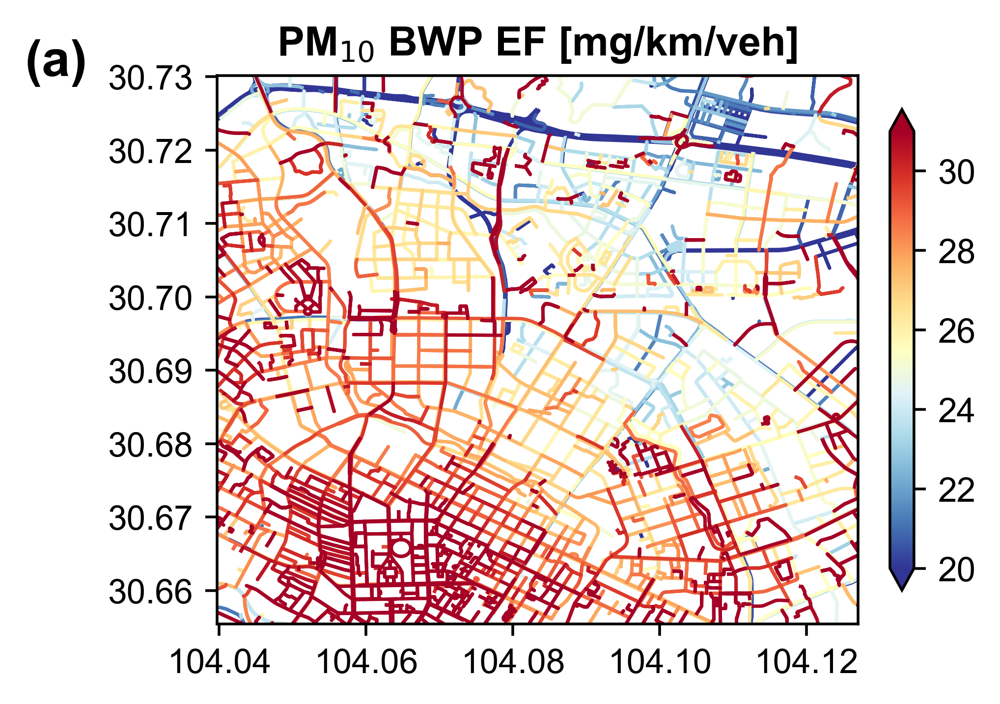

In [89]:
fig, ax = plt.subplots(1,1, figsize=(4,4), constrained_layout=True)

### EF heat ###
road_heat(ax, 'PM10 EF Avg', 'PM10 BWP EF [mg/vkm]', 'RdYlBu_r', 20, 31, None, agg_link)
ax.text(-0.3, 1, "(a)", transform=ax.transAxes, fontdict=LABEL_FONT, fontsize=15)
ax.set_title('PM$_{10}$ BWP EF [mg/km/veh]', fontdict=LABEL_FONT)
plt.show()

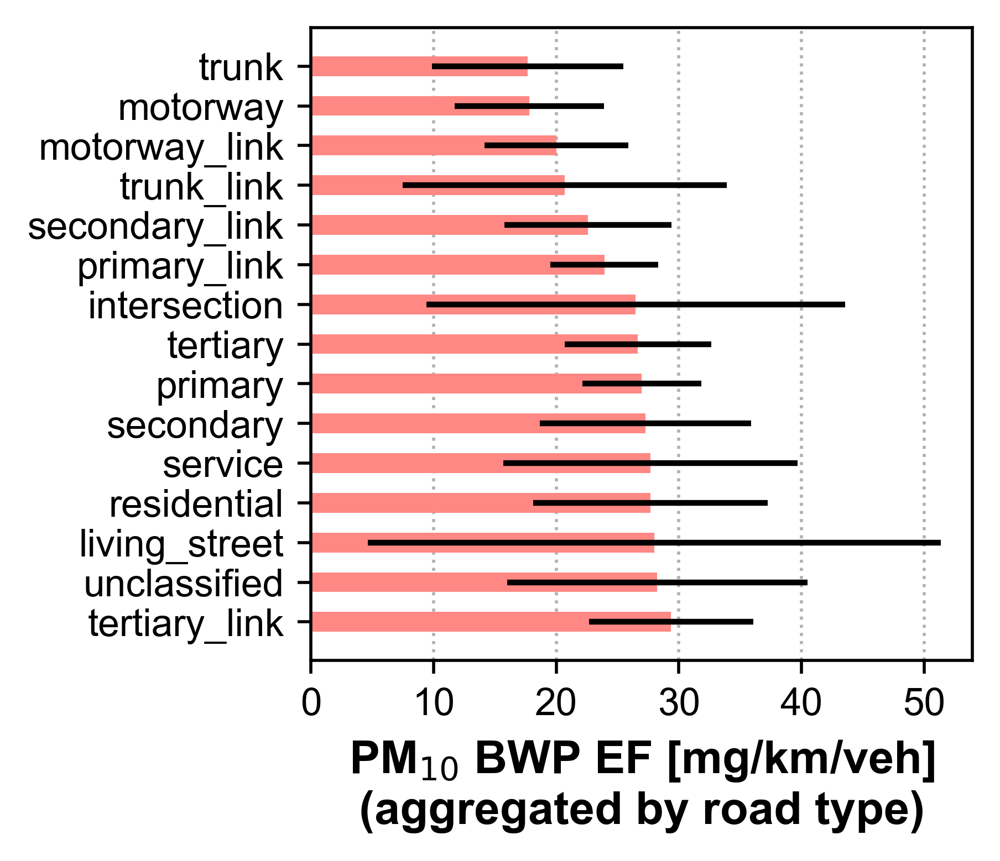

In [60]:
fig, ax = plt.subplots(1,1, figsize=(3.5,3), constrained_layout=True)

### EF bar ###
type_bar(ax, 'PM10 EF Avg', 'PM10 BWP EF [mg/vkm]', PINK,  agg_type)
ax.set_xticks(np.arange(0,55,10), np.arange(0,55,10))
ax.set_xlabel('PM$_{10}$ BWP EF [mg/km/veh]\n(aggregated by road type)', fontdict=LABEL_FONT)
# ax.set_title('PM$_{10}$ BWP EF [mg/km/veh]\n(aggregated by road type)', fontdict=LABEL_FONT)
# ax.set_xlabel('')
plt.show()

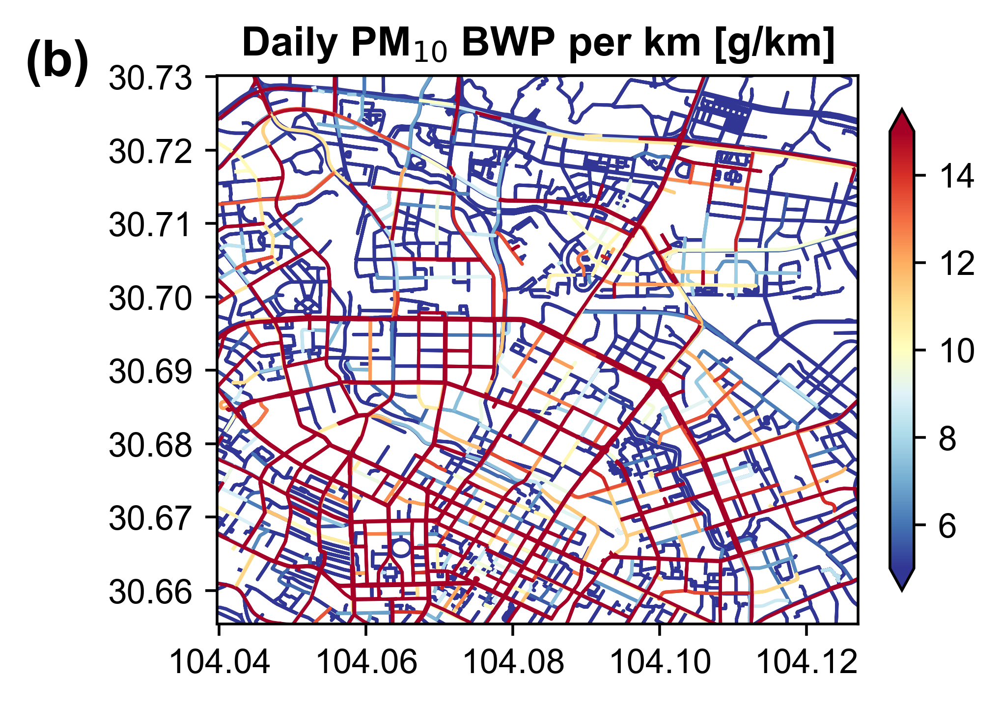

In [90]:
agg_link['BWE per km'] = agg_link['Daily BWE'] / agg_link['length'] * 1000

fig, ax = plt.subplots(1,1, figsize=(4,4), constrained_layout=True)

### EF heat ###
road_heat(ax, 'BWE per km', 'Daily BWP per km [g/km]', 'RdYlBu_r', 5, 15, None, agg_link)
ax.text(-0.3, 1, "(b)", transform=ax.transAxes, fontdict=LABEL_FONT, fontsize=15)
ax.set_title('Daily PM$_{10}$ BWP per km [g/km]', fontdict=LABEL_FONT)
plt.show()

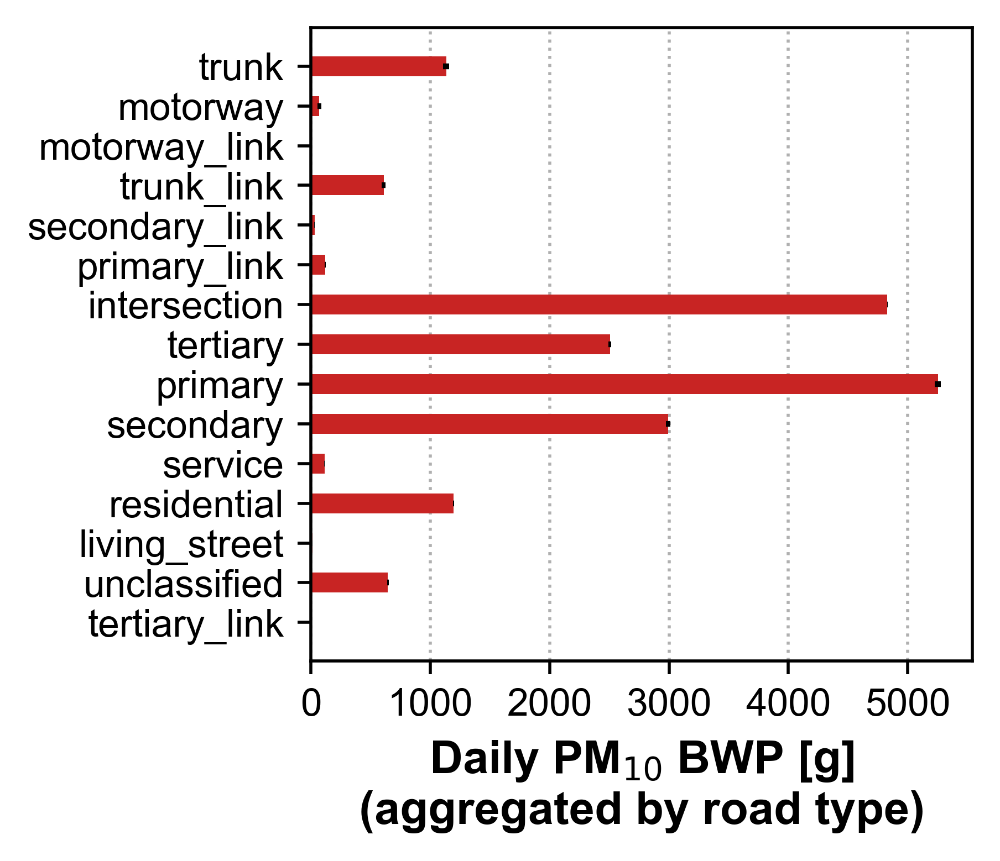

In [61]:
fig, ax = plt.subplots(1,1, figsize=(3.5,3), constrained_layout=True)

### EF bar ###
type_bar(ax, 'Daily BWE', 'Daily PM10 BWE [g]', RED, agg_type)
ax.set_xticks(np.arange(0,5500,1000), np.arange(0,5500,1000))
ax.set_xlabel('Daily PM$_{10}$ BWP [g]\n(aggregated by road type)', fontdict=LABEL_FONT)
plt.show()

In [28]:
DailyBWENode = agg_node['Daily BWE'].sum()
DailyBWESum = agg_link['Daily BWE'].sum()
DailyBWENode / DailyBWESum

0.32884517

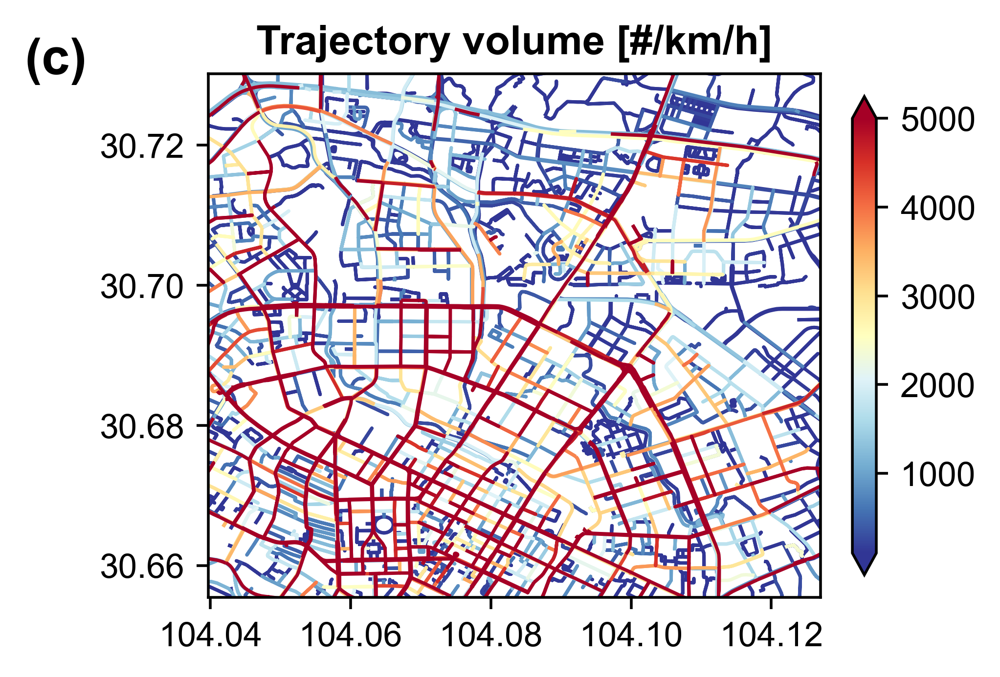

In [99]:
fig, ax = plt.subplots(1,1, figsize=(4,4), constrained_layout=True)

### EF heat ###
road_heat(ax, 'trajVol', 'Trajectory volume [#/km/h]', 'RdYlBu_r', 100, 5000, None, agg_link)
# ax.set_yticks(list(range(30.66, 30.74, 0.01)))
ax.text(-0.3, 1, "(c)", transform=ax.transAxes, fontdict=LABEL_FONT, fontsize=15)
ax.set_title('Trajectory volume [#/km/h]', fontdict=LABEL_FONT)
plt.show()

In [44]:
# trajectory per hour
agg_type['trajVol_hour'] = agg_type['trajCount'] / 30 / 24 / 1000  # #/h thousand
agg_type['trajVol_hour'].describe()

count      15.000000
mean      366.135720
std       505.565686
min         1.215208
25%        13.090774
50%       146.175432
75%       531.361712
max      1487.150804
Name: trajVol_hour, dtype: float64

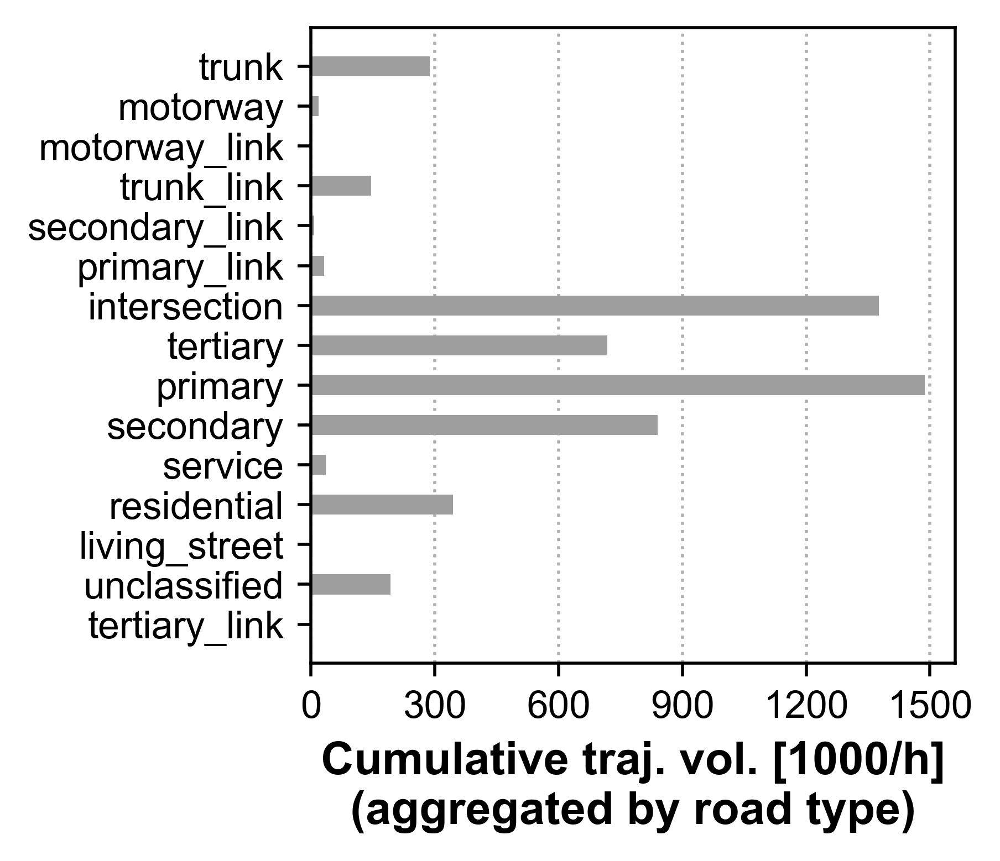

In [65]:
fig, ax = plt.subplots(1,1, figsize=(3.5,3), constrained_layout=True)

### EF bar ###
type_bar(ax, 'trajVol_hour', 'Cumulative traj. volume [1000/h]', GREY, agg_type, False)
# ax.set_xticks(np.arange(0,5500,1000), np.arange(0,5500,1000))
ax.set_xticks(list(range(0, 1600, 300)))
ax.set_xlabel('Cumulative traj. vol. [1000/h]\n(aggregated by road type)', fontdict=LABEL_FONT)
plt.show()

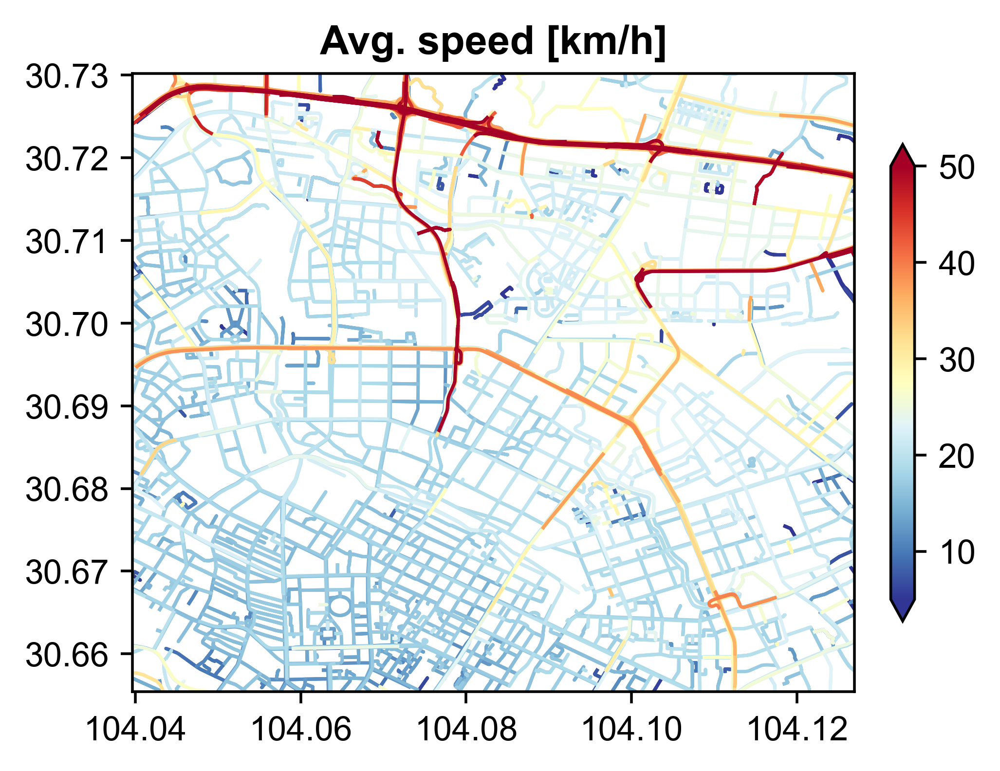

In [18]:
fig, ax = plt.subplots(1,1, figsize=(4,4), constrained_layout=True)

### EF heat ###
road_heat(ax, 'speedMean', 'Avg. speed [km/h]', 'RdYlBu_r', 5, 50, None, agg_link)
# ax.set_yticks(list(range(30.66, 30.74, 0.01)))
ax.text(-0.3, 1, "", transform=ax.transAxes, fontdict=LABEL_FONT, fontsize=15)
ax.set_title('Avg. speed [km/h]', fontdict=LABEL_FONT)
plt.show()

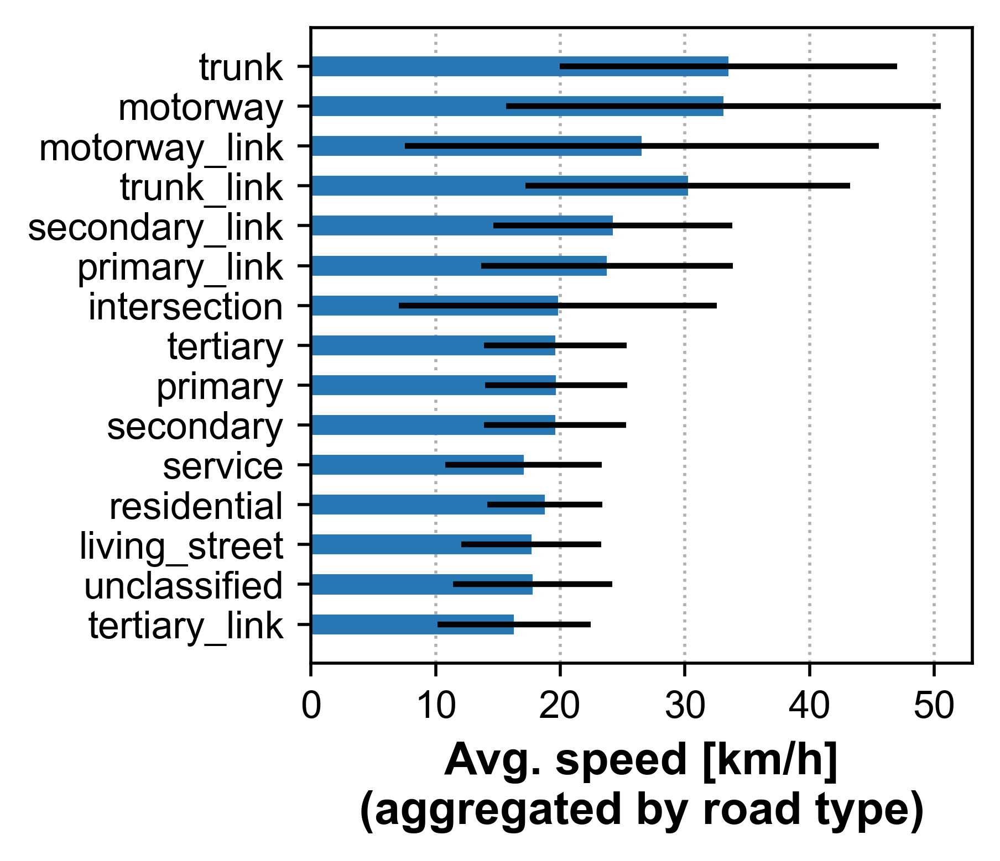

In [21]:
fig, ax = plt.subplots(1,1, figsize=(3.5,3), constrained_layout=True)

### EF bar ###
type_bar(ax, 'speedMean', 'Avg. speed [km/h]', BLUE, agg_type, True)
# ax.set_xticks(np.arange(0,5500,1000), np.arange(0,5500,1000))
ax.set_xticks(list(range(0, 60, 10)))
ax.set_xlabel('Avg. speed [km/h]\n(aggregated by road type)', fontdict=LABEL_FONT)
plt.show()

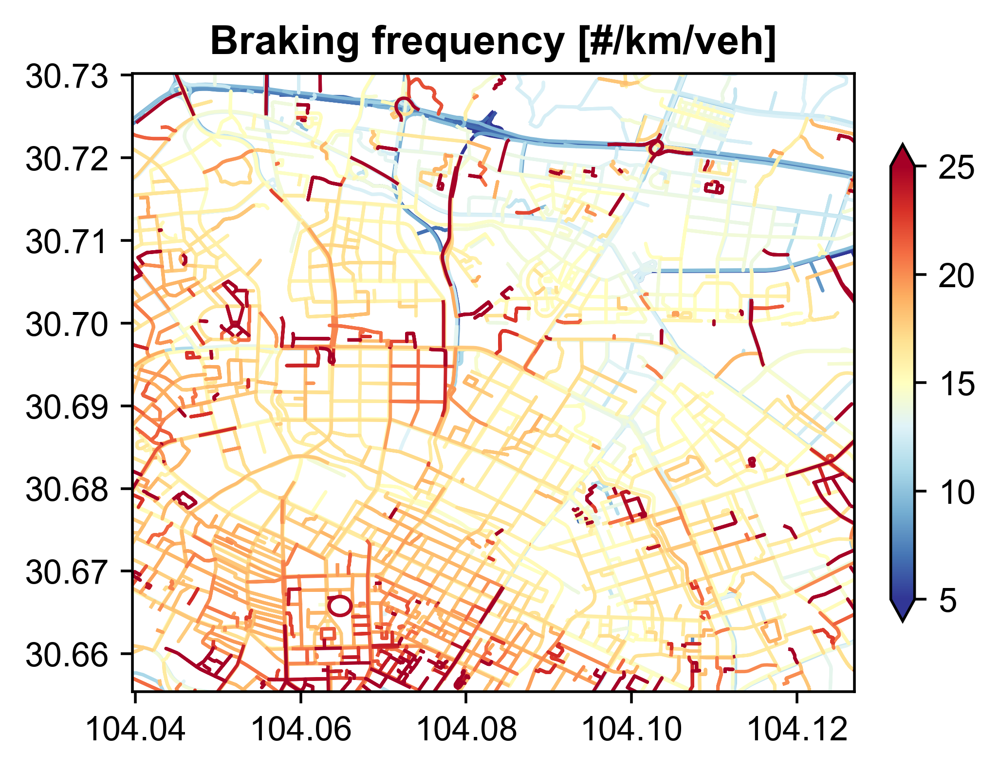

In [34]:
fig, ax = plt.subplots(1,1, figsize=(4,4), constrained_layout=True)

### EF heat ###
road_heat(ax, 'brakeFreq', 'Braking frequency [#/km/veh]', 'RdYlBu_r', 5, 25, None, agg_link)
# ax.set_yticks(list(range(30.66, 30.74, 0.01)))
ax.text(-0.3, 1, "", transform=ax.transAxes, fontdict=LABEL_FONT, fontsize=15)
ax.set_title('Braking frequency [#/km/veh]', fontdict=LABEL_FONT)
plt.show()

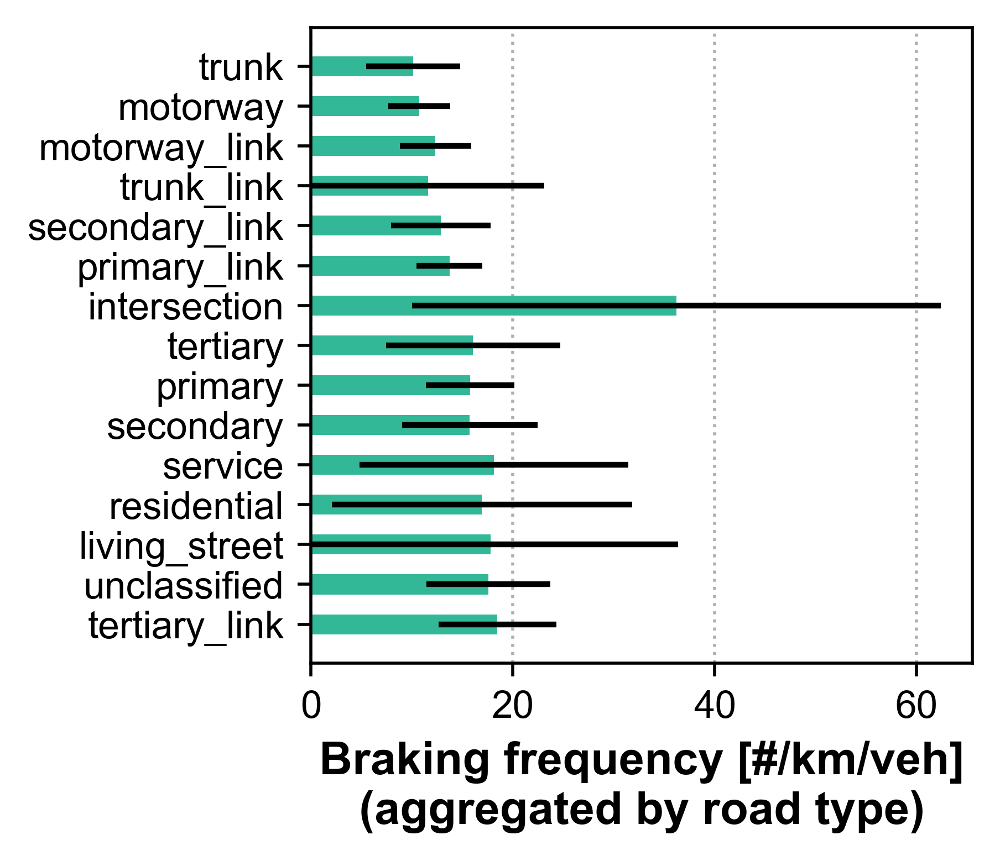

In [33]:
fig, ax = plt.subplots(1,1, figsize=(3.5,3), constrained_layout=True)

### EF bar ###
type_bar(ax, 'brakeFreq', 'Braking frequency [#/km/veh]', DEEPGREEN, agg_type, True)
# ax.set_xticks(np.arange(0,5500,1000), np.arange(0,5500,1000))
ax.set_xticks(list(range(0, 70, 20)))
ax.set_xlim(0,)
ax.set_xlabel('Braking frequency [#/km/veh]\n(aggregated by road type)', fontdict=LABEL_FONT)
plt.show()

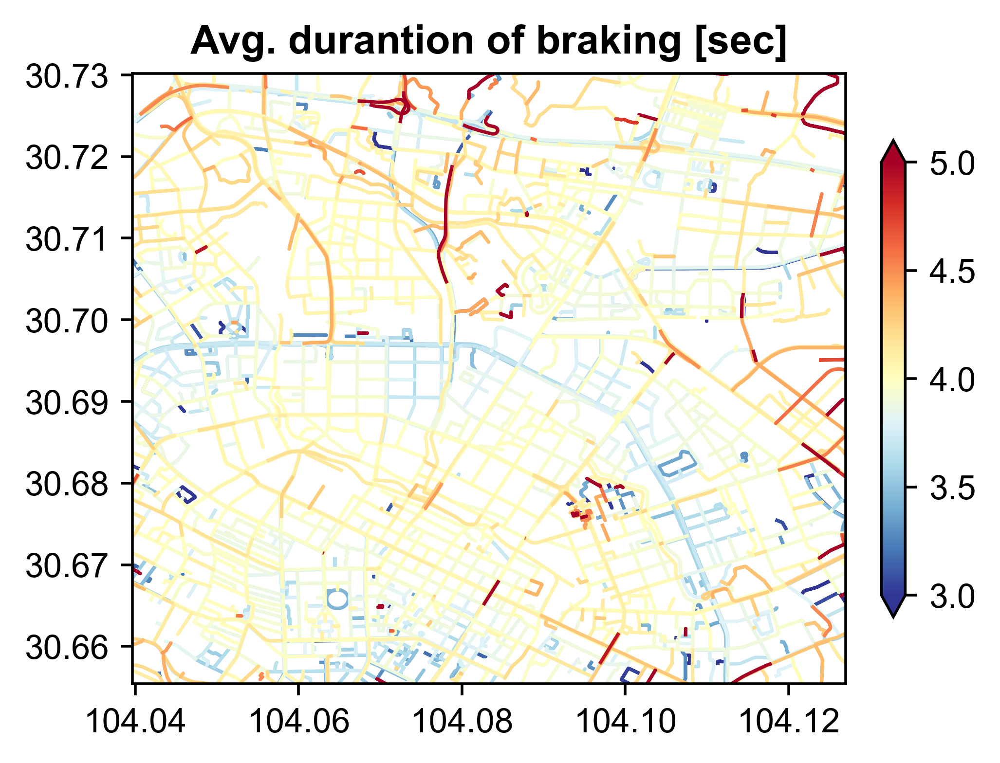

In [27]:
fig, ax = plt.subplots(1,1, figsize=(4,4), constrained_layout=True)

### EF heat ###
road_heat(ax, 'brakeTimeMean', 'Avg. durantion of braking [sec]', 'RdYlBu_r', 3, 5, None, agg_link)
# ax.set_yticks(list(range(30.66, 30.74, 0.01)))
ax.text(-0.3, 1, "", transform=ax.transAxes, fontdict=LABEL_FONT, fontsize=15)
ax.set_title('Avg. durantion of braking [sec]', fontdict=LABEL_FONT)
plt.show()

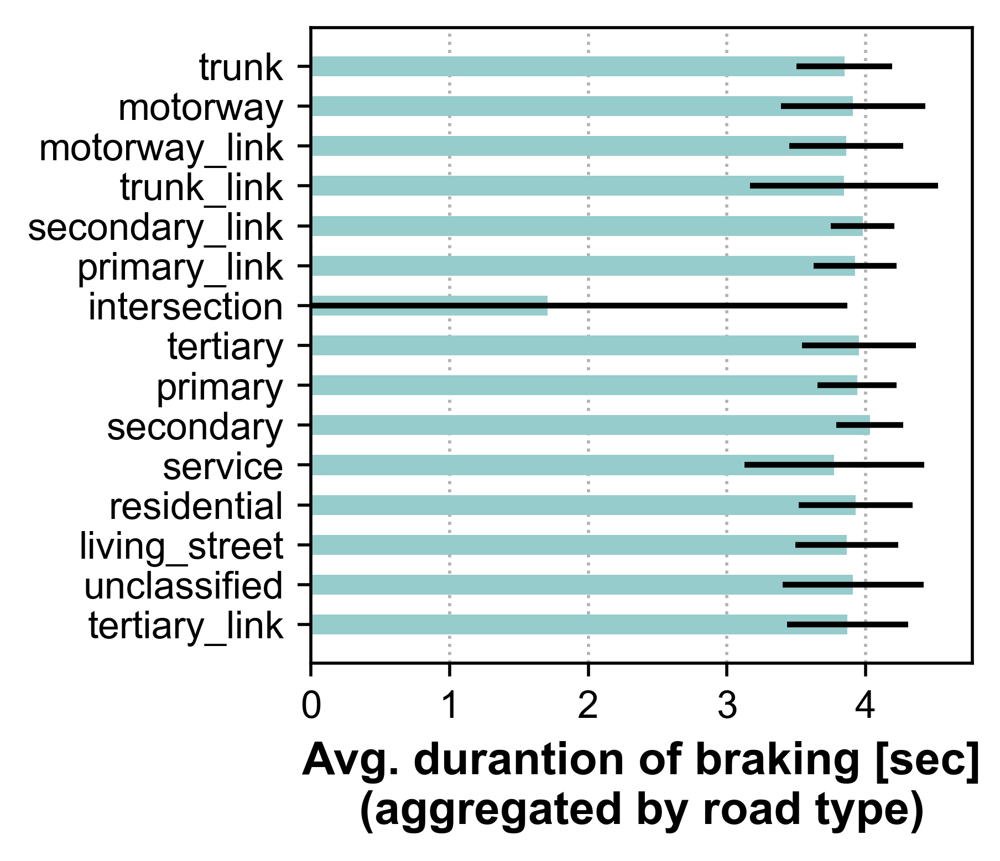

In [32]:
fig, ax = plt.subplots(1,1, figsize=(3.5,3), constrained_layout=True)

### EF bar ###
type_bar(ax, 'brakeTimeMean', 'Avg. durantion of braking [sec]', GREEN, agg_type, True)
# ax.set_xticks(np.arange(0,5500,1000), np.arange(0,5500,1000))
# ax.set_xticks(list(range(0.0, 4.5, 1)))
ax.set_xlim(0,)
ax.set_xlabel('Avg. durantion of braking [sec]\n(aggregated by road type)', fontdict=LABEL_FONT)
plt.show()

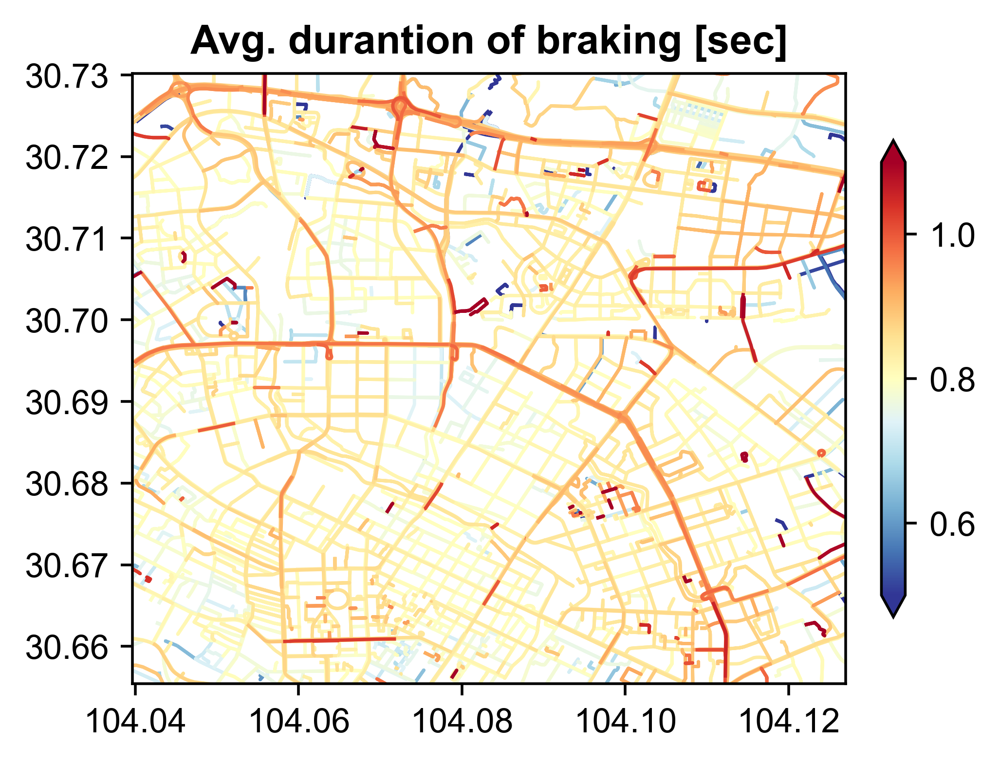

In [35]:
fig, ax = plt.subplots(1,1, figsize=(4,4), constrained_layout=True)

### EF heat ###
road_heat(ax, 'brakeDecelMean', 'Avg. decel. of braking [m/s$^2$]', 'RdYlBu_r', 0.5, 1.1, None, agg_link)
# ax.set_yticks(list(range(30.66, 30.74, 0.01)))
ax.text(-0.3, 1, "", transform=ax.transAxes, fontdict=LABEL_FONT, fontsize=15)
ax.set_title('Avg. durantion of braking [sec]', fontdict=LABEL_FONT)
plt.show()

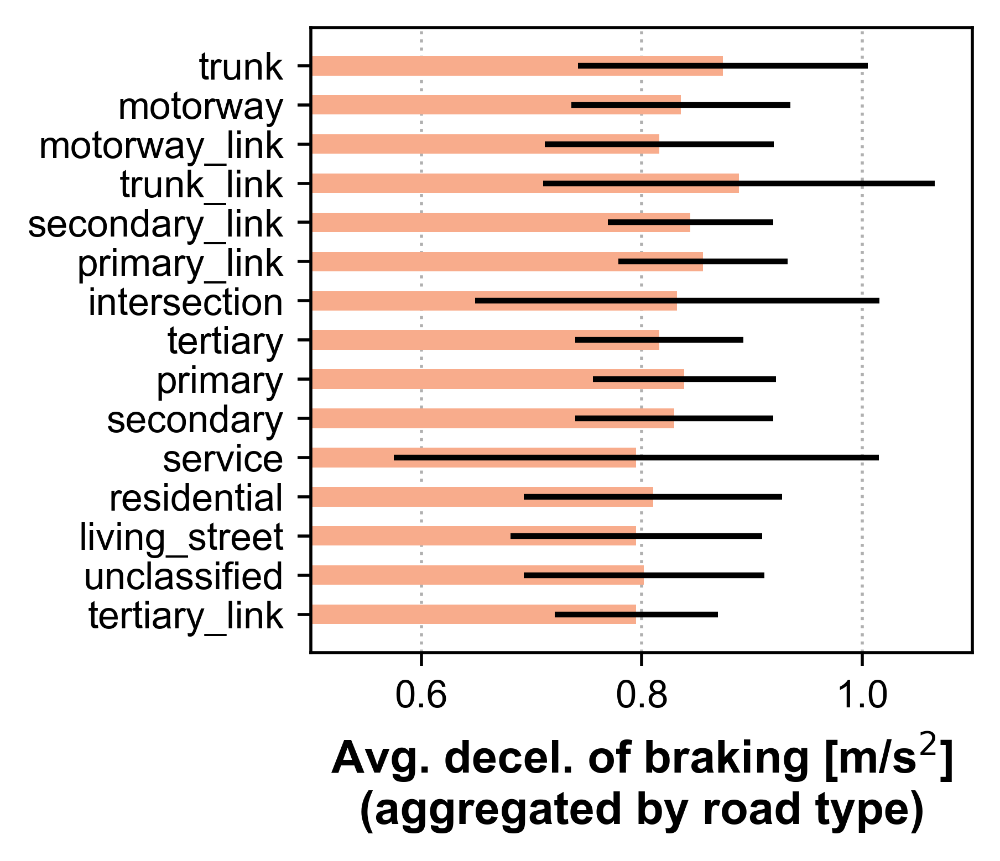

In [36]:
fig, ax = plt.subplots(1,1, figsize=(3.5,3), constrained_layout=True)

### EF bar ###
type_bar(ax, 'brakeDecelMean', 'Avg. decel. of braking [m/s$^2$]', ORANGE, agg_type, True)
# ax.set_xticks(np.arange(0,5500,1000), np.arange(0,5500,1000))
# ax.set_xticks(list(range(0.0, 4.5, 1)))
ax.set_xlim(0.5, 1.1)
ax.set_xlabel('Avg. decel. of braking [m/s$^2$]\n(aggregated by road type)', fontdict=LABEL_FONT)
plt.show()

BWP emissions from intersections account up to 32.89% of the total.

In [67]:
def road_heat(ax, col, label, cmap, vmin, vmax, subID, agg_link):
    """heat map for road"""
    agg_link = agg_link.sort_values(by=col)
    agg_link.plot(ax=ax, column=col, cmap=cmap, linewidth=1, vmin=vmin, vmax=vmax, zorder=0)
    # agg_node.plot(ax=ax, column=col, cmap=cmap, markersize=2, alpha=0.4, vmin=vmin, vmax=vmax, zorder=10)
    ax.set_xlim(west, east)
    ax.set_ylim(south, north)
    cbar = fig.colorbar(plt.cm.ScalarMappable(
                            norm=Normalize(vmin, vmax),
                            cmap=cmap),
                        ax=ax, location='right', shrink=0.8, extend='both')
    # cbar.set_label(label=label, fontdict=LABEL_FONT, fontsize=14)
    ax.text(-0.28, 1, subID, transform=ax.transAxes, fontdict=LABEL_FONT, fontsize=22)
    ax.set_title(label, fontdict=LABEL_FONT, fontsize=16)

def type_bar(ax, col, label, color, aggFile, error=True):
    if error:
        ax.barh(aggFile.index, aggFile[col], height=0.5, xerr=errors[col], color=color, zorder=2)
    else:
        ax.barh(aggFile.index, aggFile[col], height=0.5, color=color, zorder=2)
    ax.set_xlabel("%s\n(aggregated by road type)" % (label), fontdict=LABEL_FONT, fontsize=16)
    ax.tick_params(axis='y', labelsize=15)
    ax.grid(axis='x', linestyle=":", zorder=0)
    ax.invert_yaxis()

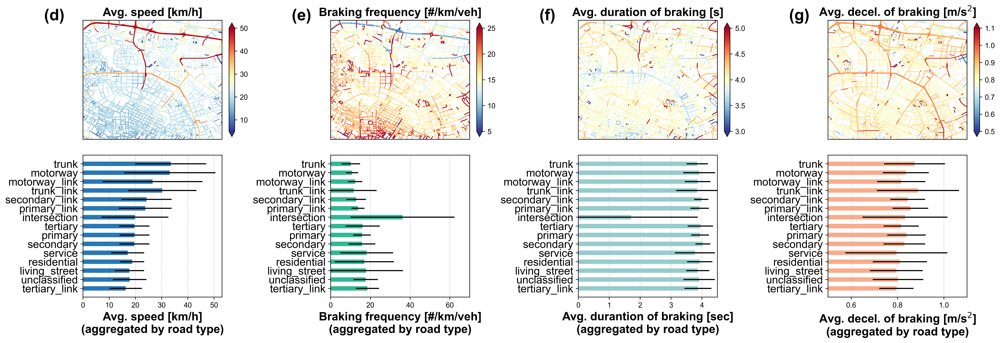

In [69]:
# fig, ax = plt.subplots(2,5, figsize=(19,5))
fig, ax = plt.subplots(2,4, figsize=(19,6.5), constrained_layout=True)
ax = ax.flatten()

i=0
### Avg speed heat ###
road_heat(ax[i], 'speedMean', 'Avg. speed [km/h]', 'RdYlBu_r', 5, 50, "(d)", agg_link)

i += 1
### brake freq heat ###
road_heat(ax[i], 'brakeFreq', 'Braking frequency [#/km/veh]', 'RdYlBu_r', 5, 25, "(e)", agg_link)

i += 1
### brake freq heat ###
road_heat(ax[i], 'brakeTimeMean', 'Avg. duration of braking [s]', 'RdYlBu_r', 3, 5, "(f)", agg_link)

i += 1
### Avg decel heat ###
road_heat(ax[i], 'brakeDecelMean', 'Avg. decel. of braking [m/s$^2$]', 'RdYlBu_r', 0.5, 1.1, "(g)", agg_link)

i += 1
### Avg speed bar ###
type_bar(ax[i], 'speedMean', 'Avg. speed [km/h]', BLUE, agg_type)
ax[i].set_xlim(0,)

i += 1
### brake freq bar ###
type_bar(ax[i], 'brakeFreq', 'Braking frequency [#/km/veh]', DEEPGREEN, agg_type)
ax[i].set_xlim(0, 70)

i += 1
### brake freq bar ###
type_bar(ax[i], 'brakeTimeMean', 'Avg. durantion of braking [sec]', GREEN, agg_type)
ax[i].set_xlim(0, 4.5)

i += 1
### Avg speed bar ###
type_bar(ax[i], 'brakeDecelMean', 'Avg. decel. of braking [m/s$^2$]', ORANGE, agg_type)
ax[i].set_xlim(0.5, 1.1)

for ax_ in [ax[i] for i in range(4)]:
    ax_.set_xticks([])
    ax_.set_yticks([])
plt.show()

## 4 Emission Hotspots

We obtain POI from `osmnx`.

In [70]:
import osmnx as ox

In [71]:
residential_tags = {
    # 'building': ['apartments', 'detached', 'dormitory', 'house', 'residential', 'terrace'],
    'landuse': ['residential']
}
residential_gdf = ox.features_from_bbox(north, south, east, west, residential_tags)

In [72]:
commercial_tags = {
    # 'building': ['hotel', 'commercial', 'office', 'retail', 'supermarket', 'bank'],
    'landuse': ['commercial', 'retail']
}
commercial_gdf = ox.features_from_bbox(north, south, east, west, commercial_tags)

In [73]:
education_tags = {
    'amenity': ['college', 'kindergarten', 'school', 'university'],
    'building': ['college', 'school', 'university'],
    'landuse': ['education']
}
education_gdf = ox.features_from_bbox(north, south, east, west, education_tags)

In [74]:
healthcare_tags = {
    'amenity': ['clinic', 'dentist', 'hospital', 'pharmacy'],
    'building': ['hospital']
}
healthcare_gdf = ox.features_from_bbox(north, south, east, west, healthcare_tags)

In [75]:
# colors
RESIDENTIAL = '#2878B5'
HEALTHCARE = '#DAA520'
EDUCATION = '#32B897'
COMMERCIAL = '#87CEEB'

In [38]:
# from matplotlib.patches import Patch

# fig, ax = plt.subplots(1,1, figsize=(5,4), constrained_layout=True)
# # road map
# agg_link.plot(ax=ax, linewidth=1, color=GREY, alpha=0.6, zorder=0)

# poi_gdfs = [residential_gdf, commercial_gdf, healthcare_gdf, education_gdf]
# pois = ['residential', 'commercial', 'healthcare', 'education']
# colors = [RESIDENTIAL, HEALTHCARE, EDUCATION, COMMERCIAL]
# for poi, poi_gdf, color in zip(pois, poi_gdfs, colors):
#     poi_gdf.plot(ax=ax, color=color, linewidth=1, markersize=1, alpha=0.8, zorder=10, label=poi)

# ax.set_xlim(west, east)
# ax.set_ylim(south, north)
# ax.set_title('POIs', fontdict=LABEL_FONT)

# legend_elements = [Patch(facecolor=color, edgecolor='none', label=poi) for color, poi in zip(colors, pois)]
# ax.legend(handles=legend_elements, bbox_to_anchor=(1.35, 0.8), bbox_transform=ax.transAxes, fontsize=8, shadow=True)
# plt.show()

### Grid analysis

In [82]:
from shapely import geometry

minX, minY, maxX, maxY =  west, south, east, north
x, y = (minX, minY)

geom_array = []

# hex grid
honeycomb_size = 0.008  # 890.56 meters, 2.053 square km
i = 1
while y <= maxY:
    while x <= maxX:
        geom = geometry.Polygon([(x,y-honeycomb_size), 
                                 (x+pow(3,0.5)/2*honeycomb_size, y-0.5*honeycomb_size), 
                                 (x+pow(3,0.5)/2*honeycomb_size, y+0.5*honeycomb_size), 
                                 (x,y+honeycomb_size),
                                 (x-pow(3,0.5)/2*honeycomb_size, y+0.5*honeycomb_size),
                                 (x-pow(3,0.5)/2*honeycomb_size, y-0.5*honeycomb_size), 
                                 (x,y-honeycomb_size)])
        geom_array.append(geom)
        x += pow(3,0.5)*honeycomb_size
    i += 1
    y += 1.5*honeycomb_size
    if i % 2 == 0:   
        x = minX + pow(3,0.5)/2*honeycomb_size
    else:
        x = minX
square = gpd.GeoDataFrame(geometry = geom_array,
                             crs = agg_link.crs)

# aggregate and merge
agg_grid_merge = gpd.sjoin(agg_link[['geometry', 'Daily BWE']], square, how='left', op='within')
agg_grid = agg_grid_merge.dissolve(by='index_right', aggfunc='sum')
agg_grid['geometry'] = square['geometry']

d:\Software\Anaconda3\envs\geo\Lib\site-packages\IPython\core\interactiveshell.py:3445: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


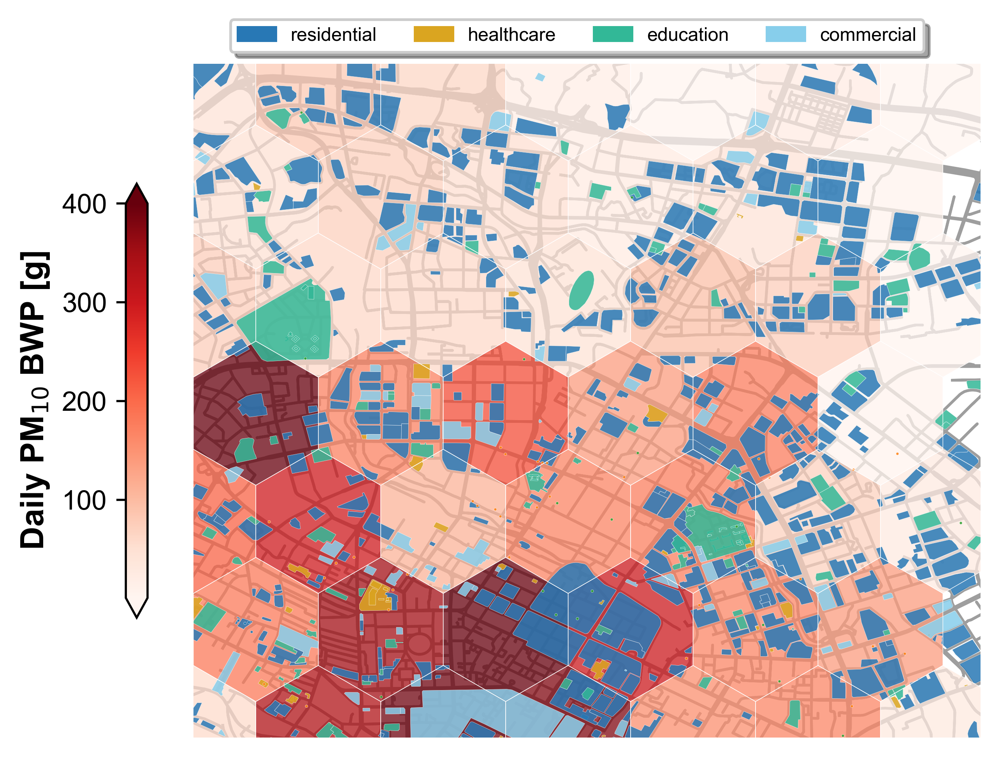

In [83]:
from matplotlib.patches import Patch

fig, ax = plt.subplots(1,1, figsize=(5,4), constrained_layout=True)

# road map
agg_link.plot(ax=ax, linewidth=1, color=GREY, alpha=1., zorder=5)

# POI
poi_gdfs = [residential_gdf, healthcare_gdf, education_gdf, commercial_gdf]
pois = ['residential', 'healthcare', 'education', 'commercial']
colors = [RESIDENTIAL, HEALTHCARE, EDUCATION, COMMERCIAL]
for poi, poi_gdf, color in zip(pois, poi_gdfs, colors):
    # poi_gdf.plot(ax=ax, facecolor=color, edgecolor='k', linewidth=0.3, markersize=1, alpha=.9, zorder=10, label=poi)
    poi_gdf.plot(ax=ax, facecolor=color, edgecolor='white', linewidth=0.1, markersize=1, alpha=.85, zorder=10, label=poi)

legend_elements = [Patch(facecolor=color, edgecolor=color, label=poi) for color, poi in zip(colors, pois)]
ax.legend(handles=legend_elements, bbox_to_anchor=(0.94, 1.08), bbox_transform=ax.transAxes, ncol=4, fontsize=7, shadow=True)

# grid
vmin, vmax = agg_grid['Daily BWE'].min(), agg_grid['Daily BWE'].max()
label = 'Daily PM$_{10}$ BWP [g]'
cmap='Reds'
agg_grid.plot(ax=ax, column='Daily BWE', edgecolor='white', linewidth=0.0, cmap=cmap, vmin=vmin, vmax=400, alpha=0.75, zorder=5)
agg_grid.plot(ax=ax, edgecolor='white', facecolor='none', linewidth=0.2, zorder=15)
cbar = fig.colorbar(plt.cm.ScalarMappable(
                        norm=Normalize(vmin, 400),
                        cmap=cmap),
                    ax=ax, location='left', shrink=0.6, extend='both')
cbar.set_label(label=label, fontdict=LABEL_FONT, fontsize=12)

ax.set_xlim(west, east)
ax.set_ylim(south, north)
plt.axis('off')
plt.show()

In [84]:
# get number of POI in each grid
square = gpd.GeoDataFrame(geometry = geom_array, crs = 'epsg:4326')

residential_gdf['num'] = 1
gird_residential = gpd.sjoin(residential_gdf[['geometry', 'num']], square, how='left', op='within')
gird_residential = gird_residential.dissolve(by='index_right', aggfunc='sum')

commercial_gdf['num'] = 1
gird_commercial = gpd.sjoin(commercial_gdf[['geometry', 'num']], square, how='left', op='within')
gird_commercial = gird_commercial.dissolve(by='index_right', aggfunc='sum')

education_gdf['num'] = 1
gird_education = gpd.sjoin(education_gdf[['geometry', 'num']], square, how='left', op='within')
gird_education = gird_education.dissolve(by='index_right', aggfunc='sum')

healthcare_gdf['num'] = 1
gird_healthcare = gpd.sjoin(healthcare_gdf[['geometry', 'num']], square, how='left', op='within')
gird_healthcare = gird_healthcare.dissolve(by='index_right', aggfunc='sum')

# calculate num
agg_grid['residential_num'] = gird_residential['num']
agg_grid['commercial_num'] = gird_commercial['num']
agg_grid['education_num'] = gird_education['num']
agg_grid['healthcare_num'] = gird_healthcare['num']
agg_grid['poi_num'] = agg_grid['residential_num'] + agg_grid['commercial_num'] + agg_grid['education_num'] + agg_grid['healthcare_num']
agg_grid.fillna(0, inplace=True)

d:\Software\Anaconda3\envs\geo\Lib\site-packages\IPython\core\interactiveshell.py:3445: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):
d:\Software\Anaconda3\envs\geo\Lib\site-packages\IPython\core\interactiveshell.py:3445: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):
d:\Software\Anaconda3\envs\geo\Lib\site-packages\IPython\core\interactiveshell.py:3445: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):
d:\Software\Anaconda3\envs\geo\Lib\site-packages\IPython\core\interactiveshell.py:3445: FutureWarning: The `op` parameter is deprecated and will be removed in a future release

In [85]:
# fit linear model (poi-bwe)
from scipy.stats import linregress as LR

lines = {poi:None for poi in pois}
y = agg_grid['Daily BWE']
for poi in pois:
    x = agg_grid['%s_num'%poi]
    lines[poi] = LR(x, y, 'greater')

x = agg_grid['poi_num']
lines['poi'] = LR(x, y, 'greater')

In [86]:
# p-value
for line in lines.values():
    print(line.pvalue)

0.3105257677995329
0.000376666895187748
0.18931242637685947
0.003106995884810777
0.0015886688329133087


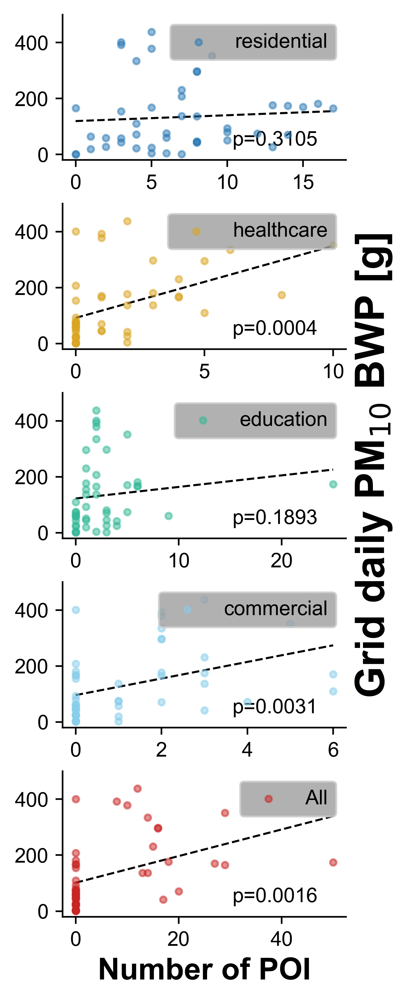

In [87]:
fig, ax = plt.subplots(5,1,figsize=(2.5,8))
ax = ax.flatten()
fig.subplots_adjust(hspace=0.3)

colors = [RESIDENTIAL, HEALTHCARE, EDUCATION, COMMERCIAL, RED]
for i, poi in enumerate(lines.keys()):
    x = np.arange(agg_grid['%s_num'%poi].min(), agg_grid['%s_num'%poi].max()+0.5, 0.5)
    ax[i].plot(x, lines[poi].intercept + lines[poi].slope*x, linewidth=1, linestyle='--', color='k')
    ax[i].scatter(agg_grid['%s_num'%poi], agg_grid['Daily BWE'], marker='o', c=colors[i], s=10, alpha=0.5, label=poi if i<4 else "All", zorder=10)
    ax[i].text(0.9, 0.1, 'p=%.4f' % lines[poi].pvalue, transform = ax[i].transAxes, ha='right')

    ax[i].set_yticks(np.arange(0,500,200))
    ax[i].set_ylim(-20,500)
    ax[i].legend(loc=1, fontsize=10, facecolor=GREY).set_zorder(20)
    ax[i].spines['top'].set_visible(False)
    ax[i].spines['right'].set_visible(False)

ax[4].set_xlabel("Number of POI", fontdict=LABEL_FONT, fontsize=15)
ax[2].yaxis.set_label_position("right")
ax[2].set_ylabel("Grid daily PM$_{10}$ BWP [g]", fontdict=LABEL_FONT, fontsize=20)
plt.show()